In [2]:
import numpy as np
from labjack import ljm
from time import sleep
import time
import logging
import sys
from datetime import datetime
import os
import csv

In [15]:
minutes = float(input("Enter number of minutes for which you'd like to collect data:  "))
MAX_REQUESTS = minutes*120 # MAX_REQUESTS is the number of eStreamRead calls that will be performed

# Open first found LabJack
handle = ljm.openS("ANY", "ANY", "ANY")  # Any device, Any connection, Any identifier

info = ljm.getHandleInfo(handle)
print("Opened a LabJack with Device type: %i, Connection type: %i,\n"
      "Serial number: %i, IP address: %s, Port: %i,\nMax bytes per MB: %i" %
      (info[0], info[1], info[2], ljm.numberToIP(info[3]), info[4], info[5]))

Enter number of minutes for which you'd like to collect data:  2
Opened a LabJack with Device type: 7, Connection type: 1,
Serial number: 470024022, IP address: 0.0.0.0, Port: 0,
Max bytes per MB: 64


In [16]:
# bias config
bias = float(input("Enter inputted peak-to-peak bias (in millivolts):  "))
biasPk2Pk = bias/1000
voltageDividerResistance = 1950000
gain = 160
offset = -.35/1000
calibration_factor = .71

# current config
I = biasPk2Pk / voltageDividerResistance

# resistance to temperature config
scriptDir = os.path.dirname(os.path.realpath("__file__"))
file = scriptDir + os.path.sep + "temp_and_res_lists.csv"
temp_list, res_list = np.loadtxt(file, delimiter = ",", skiprows = 0, usecols = (0, 1), unpack = True)

Enter inputted peak-to-peak bias (in millivolts):  20


In [17]:
# Setup and call eWriteNames to configure AIN on the LabJack.

# AIN+ and AIN-:
#   Negative channel = single ended (199)
#   Range: +/-1.0 V (1.0)
#   Resolution index = Default (0)
#   Settling, in microseconds = Auto (0)

pChan = []
pChan.extend(range(48,56))   # X3 positive channels
pChan.extend(range(80,88))   # X4 positive channels
pChan.extend(range(96,104))  # X5 positive channels

nChan = []
nChan.extend(range(56,64))   # X3 negative channels
nChan.extend(range(88,96))   # X4 negative channels
nChan.extend(range(104,112)) # X5 negative channels

allChannels = [item for sublist in zip(pChan, nChan) for item in sublist]

names = []
aValues = []

chanNames = allChannels[4:6]
aValues = [1]
for c in chanNames:
    names = names+["AIN%d_RANGE"%c, "AIN%d_RESOLUTION_INDEX"%c, "AIN%d_SETTLING_US"%c]
    aValues = aValues+[1.0, 0, 0]  # +/-1V range with default resolution

numFrames = len(names)
ljm.eWriteNames(handle, numFrames, names, aValues)    

# Read AINs from the LabJack with eReadNames in a loop.
numFrames = int((len(names)-1)/3)
names = []
for c in chanNames:
    names = names+["AIN%d"%c]

# Stream Configuration
numAddresses = len(chanNames)
aScanList = ljm.namesToAddresses(numAddresses, names)[0]
scanRate = 100 # 100Hz seems to work...Value must be less than (100,000/(24*2)) - which is 2kHz - for 24 differential channels
scansPerRead = int(scanRate/2)
timeList = []

try:
    # Configure and start stream
    scanRate = ljm.eStreamStart(handle, scansPerRead,numAddresses,aScanList,scanRate)
    print("\nStream started with a scan rate of %0.0f Hz." % scanRate)
    
    print("\nPerforming %i stream reads." % MAX_REQUESTS)
    start = datetime.now()
    totScans = 0
    totSkip = 0 # Total skipped samples
    
    allData = []
    
    i = 1
    while i <= MAX_REQUESTS:
        ret = ljm.eStreamRead(handle)
        
        data = ret[0]
        allData.append(data)
        timeList.append(datetime.now().strftime("%m/%d/%Y, %H:%M:%S"))
        
        scans = len(data)/numAddresses
        totScans += scans
        
        # Count the skipped samples which are indicated by -9999 values. Missed
        # samples occur after a device's stream buffer overflows and are
        # reported after auto-recover mode ends.
        curSkip = data.count(-9999.0)
        totSkip += curSkip
        
        print("\neStreamRead %i" % i)
        ainStr = ""
        for j in range(0, numAddresses):
            ainStr += "%s = %0.5f " % (chanNames[j], data[j])
#         for j in range(0, numAddresses):
#             print"  1st scan out of 
            
        print("  1st scan out of %i: %s" % (scans, ainStr))
        print("  Scans Skipped = %0.0f, Scan Backlogs: Device = %i, LJM = " \
              "%i" % (curSkip/numAddresses, ret[1], ret[2]))
        i += 1

    end = datetime.now()
    
    print("\nTotal scans = %i" % (totScans))
    tt = (end-start).seconds + float((end-start).microseconds)/1000000
    print("Time taken = %f seconds" % (tt))
    print("LJM Scan Rate = %f scans/second" % (scanRate))
    print("Timed Scan Rate = %f scans/second" % (totScans/tt))
    print("Timed Sample Rate = %f samples/second" % (totScans*numAddresses/tt))
    print("Skipped scans = %0.0f" % (totSkip/numAddresses))
except ljm.LJMError:
    ljme = sys.exc_info()[1]
    print(ljme)
except Exception:
    e = sys.exc_info()[1]
    print(e)

print("\nStop Stream")
ljm.eStreamStop(handle)

# Close handle
ljm.close(handle)


Stream started with a scan rate of 100 Hz.

Performing 240 stream reads.

eStreamRead 1
  1st scan out of 50: 50 = 0.01415 58 = 0.00081 
  Scans Skipped = 0, Scan Backlogs: Device = 4, LJM = 994

eStreamRead 2
  1st scan out of 50: 50 = 0.01441 58 = -0.00013 
  Scans Skipped = 0, Scan Backlogs: Device = 4, LJM = 944

eStreamRead 3
  1st scan out of 50: 50 = 0.01444 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 4, LJM = 894

eStreamRead 4
  1st scan out of 50: 50 = 0.01365 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 4, LJM = 844

eStreamRead 5
  1st scan out of 50: 50 = 0.01453 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 4, LJM = 794

eStreamRead 6
  1st scan out of 50: 50 = 0.01393 58 = 0.00050 
  Scans Skipped = 0, Scan Backlogs: Device = 4, LJM = 744

eStreamRead 7
  1st scan out of 50: 50 = 0.01441 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 4, LJM = 694

eStreamRead 8
  1st scan out of 50: 50 = 0.01434 58 = 0.00018 
  Scans


eStreamRead 68
  1st scan out of 50: 50 = 0.01378 58 = -0.00013 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 8

eStreamRead 69
  1st scan out of 50: 50 = 0.01469 58 = 0.00050 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 6

eStreamRead 70
  1st scan out of 50: 50 = 0.01422 58 = 0.00050 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 4

eStreamRead 71
  1st scan out of 50: 50 = 0.01444 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 2

eStreamRead 72
  1st scan out of 50: 50 = 0.01466 58 = 0.00050 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 0

eStreamRead 73
  1st scan out of 50: 50 = 0.01437 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 10

eStreamRead 74
  1st scan out of 50: 50 = 0.01463 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 8

eStreamRead 75
  1st scan out of 50: 50 = 0.01441 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 6

eStreamRead 76
  1st scan out


eStreamRead 136
  1st scan out of 50: 50 = 0.01431 58 = 0.00081 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 4

eStreamRead 137
  1st scan out of 50: 50 = 0.01463 58 = 0.00050 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 2

eStreamRead 138
  1st scan out of 50: 50 = 0.01441 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 0

eStreamRead 139
  1st scan out of 50: 50 = 0.01453 58 = 0.00050 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 10

eStreamRead 140
  1st scan out of 50: 50 = 0.01469 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 8

eStreamRead 141
  1st scan out of 50: 50 = 0.01409 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 6

eStreamRead 142
  1st scan out of 50: 50 = 0.01447 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 4

eStreamRead 143
  1st scan out of 50: 50 = 0.01431 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 2

eStreamRead 144
  1st 


eStreamRead 203
  1st scan out of 50: 50 = 0.01472 58 = -0.00013 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 2

eStreamRead 204
  1st scan out of 50: 50 = 0.01431 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 0

eStreamRead 205
  1st scan out of 50: 50 = 0.01397 58 = 0.00050 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 10

eStreamRead 206
  1st scan out of 50: 50 = 0.01453 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 8

eStreamRead 207
  1st scan out of 50: 50 = 0.01434 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 6

eStreamRead 208
  1st scan out of 50: 50 = 0.01437 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 4

eStreamRead 209
  1st scan out of 50: 50 = 0.01456 58 = 0.00018 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 2

eStreamRead 210
  1st scan out of 50: 50 = 0.01425 58 = 0.00050 
  Scans Skipped = 0, Scan Backlogs: Device = 0, LJM = 12

eStreamRead 211
  1s

In [18]:
# csv data file
header = ['Vrms [V]','Resistance [komhs]','Temperature [mK]','Time']
f = open('data/09-14-2022_bias20mVpk2pk_5min_test001_stream.csv', 'w')
writer = csv.writer(f)
writer.writerow(header)

51

In [19]:
def Average(lst):
    return sum(lst) / len(lst)

averagedTemp = []
averagedRes = []

i = 0
while i < len(allData):
    j = 0
    cleanTemp = []
    cleanRes = []
    while j < len(allData[0])-1:
        RMS = (allData[i][j] - allData[i][j+1])*(calibration_factor*2) + offset
        if RMS > 0:
            PreampVoltage = RMS / 0.3535
            PotentialDrop = PreampVoltage / gain
            biasResistance = PotentialDrop / I
            temp = 1000*np.interp(biasResistance,res_list,temp_list)

            row = [RMS,biasResistance/1000,temp,timeList[i]]
            writer.writerow(row) # write data
            
            cleanTemp.append(temp)
            cleanRes.append(biasResistance)
        j+=2
    i+=1
    averagedTemp.append(Average(cleanTemp))
    averagedRes.append(Average(cleanRes))

In [20]:
# Close handles
f.close()

In [21]:
# i = 31
# newAveragedRes = []
# while i < len(averagedRes):
#     newAveragedRes.append(averagedRes[i]/1000)
#     i+=1
    
# i = 31
# newAveragedTemp = []
# while i < len(averagedTemp):
#     newAveragedTemp.append(averagedTemp[i]/1000)
#     i+=1
    
# i = len(averagedTemp)-len(newAveragedTemp)
# newTime = []
# while i < len(timeList):
#     newTime.append(timeList[i])
#     i+=1

In [22]:
import pandas as pd
df = pd.read_csv('data/09-14-2022_bias20mVpk2pk_5min_test001_stream.csv')
df.head()

import plotly.express as px

fig = px.line(df, x = 'Time', y = 'Temperature [mK]', title='Temperature over time at 20mV pk2pk bias')
fig2 = px.line(df, x = 'Time', y = 'Resistance [komhs]', title='Resistance over time at 20mV pk2pk bias')
fig3 = px.line(df, x = 'Time', y = 'Vrms [V]', title='Voltage over time at 20mV pk2pk bias')
fig.show()
fig2.show()
fig3.show()

# dataframe = pd.DataFrame({'time':  newTime,
#                           'Resistance [kohms]': newAveragedRes,
#                           'Temperature [mK]': newAveragedTemp})
dataframe = pd.DataFrame({'time':  timeList,
                          'Resistance [kohms]': averagedRes,
                          'Temperature [mK]': averagedTemp})

fig4 = px.line(dataframe, x = 'time', y = 'Temperature [mK]', title='Averaged temperature over time at 20mV pk2pk bias')
fig5 = px.line(dataframe, x = 'time', y = 'Resistance [kohms]', title='Averaged resistance over time at 20mV pk2pk bias')
fig4.show()
fig5.show()

In [38]:
len((dataframe['Temperature [mK]']))/2/10

12.0

In [31]:
i = 0
minuteAveraged = []
while i < 12:
    minuteAveraged.append(Average(dataframe['Temperature [mK]'][i:1+i]))
    i = i + 1

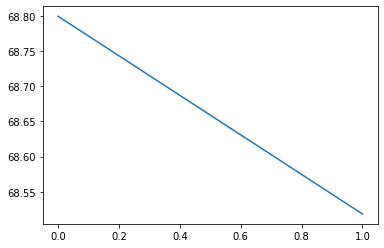

In [32]:
import matplotlib.pyplot as plt
plt.plot(minuteAveraged)

Text(0.5, 1.0, 'PSD mK / root(Hz)')

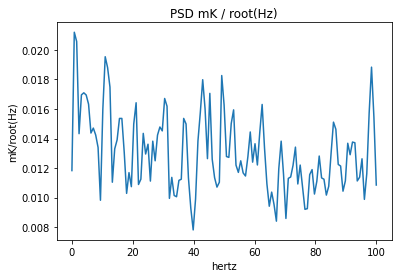

In [107]:
from scipy import signal
import matplotlib.pyplot as plt
f, pxx = signal.welch(dataframe['Temperature [mK]'], fs = 200)#K^2/Hz
plt.plot(f, np.sqrt(pxx)) #mK / sqrt(Hz)
plt.xlabel('hertz')
plt.ylabel('mK/root(Hz)')
plt.title('PSD mK / root(Hz)')

Text(0.5, 1.0, 'PSD mK / root(Hz)')

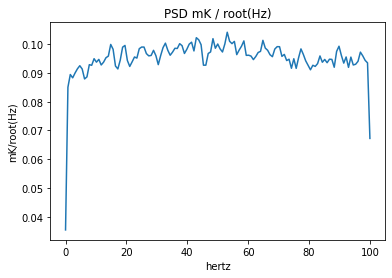

In [106]:
f, pxx = signal.welch(df['Temperature [mK]'], fs = 200)#K^2/Hz
plt.plot(f, np.sqrt(pxx)) #mK / sqrt(Hz)
plt.xlabel('hertz')
plt.ylabel('mK/root(Hz)')
plt.title('PSD mK / root(Hz)')

In [33]:
import pandas as pd
df = pd.read_csv('data/09-12-2022_bias20mVpk2pk_test000_stream.csv')
df.head()

import plotly.express as px

fig = px.line(df, x = 'Time', y = 'Temperature [mK]', title='Temperature over time at 20mV pk2pk bias')
fig2 = px.line(df, x = 'Time', y = 'Resistance [komhs]', title='Resistance over time at 20mV pk2pk bias')
fig3 = px.line(df, x = 'Time', y = 'Vrms [V]', title='Voltage over time at 20mV pk2pk bias')
fig.show()
fig2.show()
fig3.show()

# dataframe = pd.DataFrame({'time':  newTime,
#                           'Resistance [kohms]': newAveragedRes,
#                           'Temperature [mK]': newAveragedTemp})
dataframe = pd.DataFrame({'time':  timeList,
                          'Resistance [kohms]': averagedRes,
                          'Temperature [mK]': averagedTemp})

fig4 = px.line(dataframe, x = 'time', y = 'Temperature [mK]', title='Averaged temperature over time at 20mV pk2pk bias')
fig5 = px.line(dataframe, x = 'time', y = 'Resistance [kohms]', title='Averaged resistance over time at 20mV pk2pk bias')
fig4.show()
fig5.show()

In [39]:

Average(dataframe['Temperature [mK]'])

68.25526049114272

In [22]:
import pandas as pd
df = pd.read_csv('data/09-12-2022_bias040mVpk2pk_22000ohmResistor_test000_stream.csv')
df.head()

import plotly.express as px

fig = px.line(df, x = 'Time', y = 'Temperature [K]', title='Temperature over time at 40mV pk2pk bias')
fig2 = px.line(df, x = 'Time', y = 'Resistance [omhs]', title='Resistance over time at 40mV pk2pk bias')
fig3 = px.line(df, x = 'Time', y = 'Vrms [V]', title='Voltage over time at 40mV pk2pk bias')
fig.show()
fig2.show()
fig3.show()

dataframe = pd.DataFrame({'time':  timeList,
                          'Resistance [ohms]': averagedRes,
                          'Temperature [K]': averagedTemp})

fig4 = px.line(dataframe, x = 'time', y = 'Temperature [K]', title='Averaged temperature over time at 40mV pk2pk bias')
fig5 = px.line(dataframe, x = 'time', y = 'Resistance [ohms]', title='Averaged resistance over time at 40mV pk2pk bias')
fig4.show()
fig5.show()

ValueError: arrays must all be same length

In [23]:
import pandas as pd
df = pd.read_csv('data/08-03-2022_bias070mVpk2pk_22000ohmResistor_test000_stream.csv')
df.head()

import plotly.express as px

fig = px.line(df, x = 'Time', y = 'Temperature [K]', title='Temperature over time at 70mV pk2pk bias')
fig2 = px.line(df, x = 'Time', y = 'Resistance [omhs]', title='Resistance over time at 70mV pk2pk bias')
fig3 = px.line(df, x = 'Time', y = 'Vrms [V]', title='Voltage over time at 70mV pk2pk bias')
fig.show()
fig2.show()
fig3.show()

dataframe = pd.DataFrame({'time':  timeList,
                          'Resistance [ohms]': averagedRes,
                          'Temperature [K]': averagedTemp})

fig4 = px.line(dataframe, x = 'time', y = 'Temperature [K]', title='Averaged temperature over time at 70mV pk2pk bias')
fig5 = px.line(dataframe, x = 'time', y = 'Resistance [ohms]', title='Averaged resistance over time at 70mV pk2pk bias')
fig4.show()
fig5.show()

ValueError: arrays must all be same length

In [52]:
import pandas as pd
df = pd.read_csv('data/08-03-2022_bias130mVpk2pk_22000ohmResistor_test000_stream.csv')
df.head()

import plotly.express as px

fig = px.line(df, x = 'Time', y = 'Temperature [K]', title='Temperature over time at 130mV pk2pk bias')
fig2 = px.line(df, x = 'Time', y = 'Resistance [omhs]', title='Resistance over time at 130mV pk2pk bias')
fig3 = px.line(df, x = 'Time', y = 'Vrms [V]', title='Voltage over time at 130mV pk2pk bias')
fig.show()
fig2.show()
fig3.show()

dataframe = pd.DataFrame({'time':  timeList,
                          'Resistance [ohms]': averagedRes,
                          'Temperature [K]': averagedTemp})

fig4 = px.line(dataframe, x = 'time', y = 'Temperature [K]', title='Averaged temperature over time at 130mV pk2pk bias')
fig5 = px.line(dataframe, x = 'time', y = 'Resistance [ohms]', title='Averaged resistance over time at 130mV pk2pk bias')
fig4.show()
fig5.show()

In [81]:
import pandas as pd
df = pd.read_csv('data/08-03-2022_bias200mVpk2pk_22000ohmResistor_test000_stream.csv')
df.head()

import plotly.express as px

fig = px.line(df, x = 'Time', y = 'Temperature [K]', title='Temperature over time at 200mV pk2pk bias')
fig2 = px.line(df, x = 'Time', y = 'Resistance [omhs]', title='Resistance over time at 200mV pk2pk bias')
fig3 = px.line(df, x = 'Time', y = 'Vrms [V]', title='Voltage over time at 200mV pk2pk bias')
fig.show()
fig2.show()
fig3.show()

dataframe = pd.DataFrame({'time':  timeList,
                          'Resistance [ohms]': averagedRes,
                          'Temperature [K]': averagedTemp})

fig4 = px.line(dataframe, x = 'time', y = 'Temperature [K]', title='Averaged temperature over time at 200mV pk2pk bias')
fig5 = px.line(dataframe, x = 'time', y = 'Resistance [ohms]', title='Averaged resistance over time at 200mV pk2pk bias')
fig4.show()
fig5.show()

In [88]:
import pandas as pd
df = pd.read_csv('data/08-03-2022_bias400mVpk2pk_22000ohmResistor_test000_stream.csv')
df.head()

import plotly.express as px

fig = px.line(df, x = 'Time', y = 'Temperature [K]', title='Temperature over time at 400mV pk2pk bias')
fig2 = px.line(df, x = 'Time', y = 'Resistance [omhs]', title='Resistance over time at 400mV pk2pk bias')
fig3 = px.line(df, x = 'Time', y = 'Vrms [V]', title='Voltage over time at 400mV pk2pk bias')
fig.show()
fig2.show()
fig3.show()

dataframe = pd.DataFrame({'time':  timeList,
                          'Resistance [ohms]': averagedRes,
                          'Temperature [K]': averagedTemp})

fig4 = px.line(dataframe, x = 'time', y = 'Temperature [K]', title='Averaged temperature over time at 400mV pk2pk bias')
fig5 = px.line(dataframe, x = 'time', y = 'Resistance [ohms]', title='Averaged resistance over time at 400mV pk2pk bias')
fig4.show()
fig5.show()

In [95]:
import pandas as pd
df = pd.read_csv('data/08-03-2022_bias800mVpk2pk_22000ohmResistor_test000_stream.csv')
df.head()

import plotly.express as px

fig = px.line(df, x = 'Time', y = 'Temperature [K]', title='Temperature over time at 800mV pk2pk bias')
fig2 = px.line(df, x = 'Time', y = 'Resistance [omhs]', title='Resistance over time at 800mV pk2pk bias')
fig3 = px.line(df, x = 'Time', y = 'Vrms [V]', title='Voltage over time at 800mV pk2pk bias')
fig.show()
fig2.show()
fig3.show()

dataframe = pd.DataFrame({'time':  timeList,
                          'Resistance [ohms]': averagedRes,
                          'Temperature [K]': averagedTemp})

fig4 = px.line(dataframe, x = 'time', y = 'Temperature [K]', title='Averaged temperature over time at 800mV pk2pk bias')
fig5 = px.line(dataframe, x = 'time', y = 'Resistance [ohms]', title='Averaged resistance over time at 800mV pk2pk bias')
fig4.show()
fig5.show()

In [104]:
import pandas as pd
df = pd.read_csv('data/08-03-2022_bias1000mVpk2pk_22000ohmResistor_test000_stream.csv')
df.head()

import plotly.express as px

fig = px.line(df, x = 'Time', y = 'Temperature [K]', title='Temperature over time at 1000mV pk2pk bias')
fig2 = px.line(df, x = 'Time', y = 'Resistance [omhs]', title='Resistance over time at 1000mV pk2pk bias')
fig3 = px.line(df, x = 'Time', y = 'Vrms [V]', title='Voltage over time at 1000mV pk2pk bias')
fig.show()
fig2.show()
fig3.show()

dataframe = pd.DataFrame({'time':  timeList,
                          'Resistance [ohms]': averagedRes,
                          'Temperature [K]': averagedTemp})

fig4 = px.line(dataframe, x = 'time', y = 'Temperature [K]', title='Averaged temperature over time at 1000mV pk2pk bias')
fig5 = px.line(dataframe, x = 'time', y = 'Resistance [ohms]', title='Averaged resistance over time at 1000mV pk2pk bias')
fig4.show()
fig5.show()

In [78]:
import pandas as pd
df = pd.read_csv('data/08-02-2022_bias010mV_22000ohmResistor_test000_stream.csv')
df.head()

import plotly.express as px

fig = px.line(df, x = 'Time', y = 'Temperature [K]', title='Temperature over time at 10mV')
fig2 = px.line(df, x = 'Time', y = 'Resistance [omhs]', title='Resistance over time at 10mV')
fig3 = px.line(df, x = 'Time', y = 'Vrms [V]', title='Voltage over time at 10mV')
fig.show()
fig2.show()
fig3.show()

fig4 = px.line(df, x = timeList, y = averagedData, title='Averaged temperature over time at 10mV')
fig4.show()

In [75]:
test = [x for x in allData[0] if x > 0]

In [76]:
len(test)

94

In [16]:
len(aValues)

7

In [177]:
totalRes = 1950000

In [178]:
current = .025 / totalRes

In [179]:
potentialDrop = current*22000

In [191]:
(potentialDrop*160)*(np.sqrt(2)/2)

0.03191045986893138

In [48]:
# import plotly.graph_objects as go
# import numpy as np

# slope = linregress(xData, resData)
# print(slope)

# xData = [.0316,.0364,.0420,.0482,.0547,.0620,.0690,.0762,.0835,.0903,.13]
# resData = [10,20,30,40,50,60,70,80,90,100,200]

# df = pd.DataFrame(dict(
#     x = xData,
#     y = resData
# ))

# fig = px.line(df, x="x", y="y", title="Unsorted Input") 
# fig.show()

In [49]:
# import matplotlib.pyplot as plt


# # lab data - 6/7/2022
# xData = [.0316,.0364,.0420,.0482,.0547,.0620,.0690,.0762,.0835,.0903,.13]
# resData = [10,20,30,40,50,60,70,80,90,100,200]

# # high bay data - 6/9/2022
# voltageData = [.0428,.0448,.047,.051,.0548,.0649,.0768,]
# biasData = [.01,.03,.05,.08,.1,.15,.2,.25,.3,.35,.4,.45,.5]

# plt.plot(resData,xData)

In [50]:
# # calculation steps:
# I = bias * voltageDividerResistance
# PotentialDrop = I * biasResistance
# PreampVoltage = gain * PotentialDrop
# RMS = PreampVoltage*(np.sqrt(2)/2)
# final = RMS - offset

# # bias config
# bias = float(input("Enter inputted bias (in volts):  "))
# voltageDividerResistance = 1900000
# gain = 160
# offset = .0227

# I = bias / voltageDividerResistance

# RMS = final + offset
# PreampVoltage = RMS / (np.sqrt(2)/2)
# PotentialDrop = PreampVoltage / gain
# biasResistance = PotentialDrop / I
# print(biasResistance)

Text(0.5, 1.0, 'Temperature vs. Resistance')

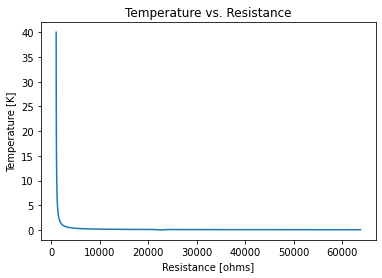

In [61]:
import matplotlib.pyplot as plt
plt.plot(xp,fp)
plt.xlabel("Resistance [ohms]")
plt.ylabel('Temperature [K]')
plt.title("Temperature vs. Resistance")